# ENSF 592 Programming Fundamentals for Data Engineers

### Project Phase II: Numpy and Pandas

By 

## Adelure Oluwasegun Michael

and

## Kenechukwu Nwabueze

#due: 13-August Thursday (11:59 midnight)

### Goal: We are going to study data analysis collected from Finding the features that can affect the number of accident in Calgary City. All data provided is based on https://data.calgary.ca/browse

In [1]:
# import liberies, packages, and plugins needed for this project 

In [2]:
import json
import csv
import pandas as pd
import numpy as np
import folium
from folium import plugins
import ipywidgets
#import geopy
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt

In [3]:
#building DataFrame from csv files
df_Traffic_Signs= pd.read_csv("Traffic_signs.csv") 
df_Traffic_Signals = pd.read_csv("Traffic_signals.csv")
df_Traffic_Incidents= pd.read_csv("Traffic_Incidents.csv")
df_Traffic_Volumes_for_2018= pd.read_csv("Traffic_Volumes_for_2018.csv")
df_Traffic_Camera_Locations=pd.read_csv("Traffic_Camera_Locations.csv")
df_Speed_Limts= pd.read_csv("Speed_Limits.csv")

In [4]:
# calgary city boundary csv file
with open(r'City_Boundary_layer.csv') as f:
    data = f.readlines()[1]

In [5]:
#Data cleaning: Replacing all the NAN with 0 and displaying a sample
df_Speed_Limts_cleaned = df_Speed_Limts.fillna(0)
df_Traffic_Signs_cleaned = df_Traffic_Signs.fillna(0)
df_Traffic_Signals_cleaned = df_Traffic_Signals.fillna(0)
df_Traffic_Incidents_cleaned =df_Traffic_Incidents.fillna(0)
df_Speed_Limts_cleaned = df_Speed_Limts_cleaned.fillna(0)
df_traffic_volume=df_Traffic_Volumes_for_2018.fillna(0)
#data
df_traffic_volume.head()

,YEAR,SECNAME,Shape_Leng,VOLUME,multilinestring
0,2018,5AVS12,172.570274,22000,MULTILINESTRING ((-114.06036700906716 51.04831...
1,2018,94AVSEWBON,189.451491,5000,MULTILINESTRING ((-114.06876825342002 50.96863...
2,2018,12STNE29,261.453939,5000,MULTILINESTRING ((-114.03372206187294 51.05323...
3,2018,100AVNE1,804.353006,2000,MULTILINESTRING ((-114.01318801277267 51.14336...
4,2018,106AVSE1,507.320869,14000,MULTILINESTRING ((-113.98128756128924 50.95784...


In [6]:
#further cleaning of the boundary data represented as data 
clean_data = data[19:]
clean_data = clean_data[:-4]
#clean_data

In [7]:
# Extracting the longitude and latirude of Calgary boundary for the plot on the map
latitude = []
longitude = []

for c in clean_data.split(','):
    lng, lat = c.split()
    latitude.append(float(lng))
    longitude.append(float(lat))

In [8]:
# Determining the minimum, mid and maximum point of the Calgary boundary
#uncomment to display the respective values
min(latitude)
min_latitude = np.min(latitude)
min(longitude)
min_longitude = np.min(longitude)
#min_longitude
#max(latitude)
max_latitude = np.max(latitude)
#max_latitude
max(longitude)
max_longitude = np.max(longitude)
#max_longitude
mid_latitude = (max_latitude + min_latitude)/2
#mid_latitude
mid_longitude = (max_longitude + min_longitude)/2
mid_longitude

51.027623500000004

In [9]:
#calgary boundary plot using this web reference 
#https://www.jpytr.com/post/analysinggeographicdatawithfolium/
map_1 = folium.Map(location=[mid_longitude,mid_latitude],control_scale=True)
bounds = [[min_longitude, min_latitude],
[max_longitude,max_latitude]]
folium.Rectangle(
    bounds,
    color='#3186cc',
    fill=True,
    fill_color='#3186cc'
).add_to(map_1)
map_1

In [10]:
from folium.plugins import MarkerCluster

In [11]:
#A test of the Traffic Incidents cluster point in the Calgary boundary location 
df_Traffic_Incidents.dropna(subset=["Latitude", "Longitude"], inplace=True)
locations = list(zip(df_Traffic_Incidents.Latitude, df_Traffic_Incidents.Longitude))
icons = [folium.Icon(icon="car", prefix="fa") for _ in range(len(locations))]
#popups=[list(df_Traffic_Incidents.DESCRIPTION)  for _ in range(len(locations))]

cluster = MarkerCluster(locations=locations, icons=icons)
map_1.add_child(cluster)
map_1

In [12]:
# defining a function for the 10X10 area grid in the location 
#ref: https://www.jpytr.com/post/analysinggeographicdatawithfolium/
def get_geojson_grid(upper_right, lower_left, n=10):
    """Returns a grid of geojson rectangles, and computes the exposure in each section of the grid based on the vessel data.

    Parameters
    ----------
    upper_right: array_like
        The upper right hand corner of "grid of grids" (the default is the upper right hand [lat, lon] of the USA).

    lower_left: array_like
        The lower left hand corner of "grid of grids"  (the default is the lower left hand [lat, lon] of the USA).

    n: integer
        The number of rows/columns in the (n,n) grid.

    Returns
    -------

    list
        List of "geojson style" dictionary objects   
    """

    all_boxes = []

    lat_steps = np.linspace(lower_left[0], upper_right[0], n+1)
    lon_steps = np.linspace(lower_left[1], upper_right[1], n+1)

    lat_stride = lat_steps[1] - lat_steps[0]
    lon_stride = lon_steps[1] - lon_steps[0]

    for lat in lat_steps[:-1]:
        for lon in lon_steps[:-1]:
            # Define dimensions of box in grid
            upper_left = [lon, lat + lat_stride]
            upper_right = [lon + lon_stride, lat + lat_stride]
            lower_right = [lon + lon_stride, lat]
            lower_left = [lon, lat]

            # Define json coordinates for polygon
            coordinates = [
                upper_left,
                upper_right,
                lower_right,
                lower_left,
                upper_left
            ]

            geo_json = {"type": "FeatureCollection",
                        "properties":{
                            "lower_left": lower_left,
                            "upper_right": upper_right
                        },
                        "features":[]}

            grid_feature = {
                "type":"Feature",
                "geometry":{
                    "type":"Polygon",
                    "coordinates": [coordinates],
                }
            }

            geo_json["features"].append(grid_feature)

            all_boxes.append(geo_json)

    return all_boxes

In [13]:
#calling the function above for the grid plot
#Re-check long,lat lower left corner
lower_left = [min_longitude, min_latitude]
#Re-check long,lat Upper right corner
upper_right = [max_longitude, max_latitude] 
# line not needed: m = folium.Map(zoom_start = 5, location=[55, 0])
grid = get_geojson_grid(upper_right, lower_left , n=10)

for i, geo_json in enumerate(grid):

    color = plt.cm.Reds(i / len(grid))
    color = mpl.colors.to_hex(color)

    gj = folium.GeoJson(geo_json,
                        style_function=lambda feature, color=color: {
                                                                        'fillColor': color,
                                                                        'color':"black",
                                                                        'weight': 2,
                                                                        'dashArray': '5, 5',
                                                                        'fillOpacity': 0.55,
                                                                    })
    popup = folium.Popup("example popup {}".format(i))
    gj.add_child(popup)

    map_1.add_child(gj)
map_1

# Average speed limit

In [14]:
df_Speed_Limts.head()
#0 to 1451

,BOUND,CREATED_DT,DISTANCE,SPEED,STREET_NAME,multiline
0,N,NaN,0.81,60,MILLSIDE BV SE,MULTILINESTRING ((-114.073657541927 50.9135772...
1,NaN,2018/10/30,NaN,40,DEERFOOT TR SE RAMP,MULTILINESTRING ((-114.034764352652 50.9962241...
2,S,2018/10/23,NaN,60,HARVEST HILLS BV N,MULTILINESTRING ((-114.068566084381 51.1667137...
3,N,2019/10/09,4.37,70,CROWCHILD TR SW,MULTILINESTRING ((-114.117825190175 51.0050022...
4,NaN,2018/10/30,NaN,80,STONEY TR NE RAMP,MULTILINESTRING ((-113.918850808952 51.0624482...


In [15]:
#Defining the x-y axis for the grid plot using numpy linspace; this represent each grid boundary
GRID_SPACING = 10
grid_x = np.linspace(min_latitude, max_latitude, GRID_SPACING + 1)
grid_y = np.linspace(min_longitude, max_longitude, GRID_SPACING + 1)

In [16]:
#iniatializing the average speed per grid using dictionary
avg_speed_grid = {}
#importing the speed limits file using csv DictReader, iterating the dataframe 
#for the locations and speed within the grid respectively
with open(r"Speed_Limits.csv") as f:
    line = csv.DictReader(f, delimiter=',')
    for row in line:
        speed = float(row['SPEED'])
        all_locations = row['multiline'][18:-2].replace("), (", ", ").split(',')
        locations = [location.split() for location in all_locations]
        
        #looping limited to the defined grid, and collating data in a list 
        for location in locations:
            for x_row in range(0, GRID_SPACING):
                for y_row in range(0, GRID_SPACING):
                    if f'{x_row},{y_row}' not in avg_speed_grid: avg_speed_grid[f'{x_row},{y_row}'] = []

                    # check if current location is in the rnge of the border of the grid row being checked
                    if grid_x[x_row] <= float(location[0]) <= grid_x[x_row+1] and grid_y[y_row-1] <= float(location[1]) <= grid_y[y_row+1]:
                        avg_speed_grid[f'{x_row},{y_row}'].append(speed)

#determining average speed per grid
for row_column in avg_speed_grid:
    value = avg_speed_grid[row_column]
    if value:
        avg_speed_grid[row_column] = sum(value)/len(value)
    else:
        avg_speed_grid[row_column] = 0

avg_speed_grid

{'0,0': 0,
 '0,1': 0,
 '0,2': 0,
 '0,3': 0,
 '0,4': 0,
 '0,5': 0,
 '0,6': 110.0,
 '0,7': 110.0,
 '0,8': 0,
 '0,9': 0,
 '1,0': 0,
 '1,1': 0,
 '1,2': 0,
 '1,3': 0,
 '1,4': 73.96825396825396,
 '1,5': 65.46583850931677,
 '1,6': 69.63048498845265,
 '1,7': 64.94300045599635,
 '1,8': 62.96296296296296,
 '1,9': 65.62700964630226,
 '2,0': 0,
 '2,1': 70.0,
 '2,2': 70.0,
 '2,3': 0,
 '2,4': 65.70743405275779,
 '2,5': 61.95413282369804,
 '2,6': 61.953298739807266,
 '2,7': 64.44311734846222,
 '2,8': 64.85671191553544,
 '2,9': 65.12449334105385,
 '3,0': 0,
 '3,1': 70.45454545454545,
 '3,2': 71.88141391106043,
 '3,3': 71.73102529960053,
 '3,4': 72.73381294964028,
 '3,5': 68.10479921645445,
 '3,6': 65.863900834809,
 '3,7': 66.78474682225463,
 '3,8': 66.05360443622921,
 '3,9': 63.71865703357416,
 '4,0': 0,
 '4,1': 62.04255319148936,
 '4,2': 63.903328773369815,
 '4,3': 63.945398502862176,
 '4,4': 60.201816347124115,
 '4,5': 58.74221991701245,
 '4,6': 59.94973471097459,
 '4,7': 63.64750633981403,
 '4,8': 

In [17]:
#Average speed of all grid
def returnAvg(myDict):
    sum=0
    for i in myDict:
        sum=sum+myDict[i]
        
    return sum/len(myDict)

In [18]:
print("Average Speed of all grid: ", returnAvg(avg_speed_grid))

Average Speed of all grid:  52.199935330067746


# Average Traffic volume

In [19]:
#same as above grid boundary definition
GRID_SPACING = 10
grid_x = np.linspace(min_latitude, max_latitude, GRID_SPACING + 1)
grid_y = np.linspace(min_longitude, max_longitude, GRID_SPACING + 1)

In [20]:
#iniatializing the average traffic volume per grid using dictionary
avg_volume_grid = {}


#importing the traffic volume file using csv DictReader, iterating the dataframe 
#for the locations and speed within the grid respectively
with open(r"Traffic_Volumes_for_2018.csv") as f:
    line = csv.DictReader(f, delimiter=',')
    for row in line:
        volume = float(row['VOLUME'])
        all_locations = row['multilinestring'][18:-2].replace("), (", ", ").split(',')
        locations = [location.split() for location in all_locations]
        
        
        #looping limited to the defined grid, and collating data in a list 
        for location in locations:
            for x_row in range(0, GRID_SPACING):
                for y_row in range(0, GRID_SPACING):
                    if f'{x_row},{y_row}' not in avg_volume_grid: avg_volume_grid[f'{x_row},{y_row}'] = []

                    # check if current location is in the rnge of the border of the grid row being checked
                    if grid_x[x_row] <= float(location[0]) <= grid_x[x_row+1] and grid_y[y_row-1] <= float(location[1]) <= grid_y[y_row+1]:
                        avg_volume_grid[f'{x_row},{y_row}'].append(volume)


#determining average volume per grid
for row_column in avg_volume_grid:
    value = avg_volume_grid[row_column]
    if value:
        avg_volume_grid[row_column] = sum(value)/len(value)
    else:
        avg_volume_grid[row_column] = 0

avg_volume_grid

{'0,0': 0,
 '0,1': 0,
 '0,2': 0,
 '0,3': 0,
 '0,4': 0,
 '0,5': 0,
 '0,6': 44000.0,
 '0,7': 44000.0,
 '0,8': 0,
 '0,9': 0,
 '1,0': 0,
 '1,1': 0,
 '1,2': 0,
 '1,3': 0,
 '1,4': 17906.976744186046,
 '1,5': 15220.338983050848,
 '1,6': 30645.320197044333,
 '1,7': 27306.184012066366,
 '1,8': 20219.45137157107,
 '1,9': 12120.448179271709,
 '2,0': 0,
 '2,1': 12352.941176470587,
 '2,2': 12352.941176470587,
 '2,3': 0,
 '2,4': 15631.578947368422,
 '2,5': 18155.397390272836,
 '2,6': 18590.283400809716,
 '2,7': 19596.808969383354,
 '2,8': 22512.36442516269,
 '2,9': 27041.055718475072,
 '3,0': 0,
 '3,1': 14358.97435897436,
 '3,2': 11647.727272727272,
 '3,3': 10472.222222222223,
 '3,4': 24393.388429752067,
 '3,5': 26124.668435013264,
 '3,6': 26006.544502617802,
 '3,7': 23061.718098415346,
 '3,8': 22409.83606557377,
 '3,9': 18170.978627671542,
 '4,0': 0,
 '4,1': 12183.471074380166,
 '4,2': 13346.422338568935,
 '4,3': 17328.633405639914,
 '4,4': 34067.29857819905,
 '4,5': 33188.38383838384,
 '4,6': 2804

# Average number of traffic cameras

In [21]:
camera_count_grid = {}

with open(r"Traffic_Camera_Locations.csv") as f:
    line = csv.DictReader(f, delimiter=',')
    for row in line:
        latitude = row['latitude']
        longitude = row['longitude']  

        for x_row in range(0, GRID_SPACING):
            for y_row in range(0, GRID_SPACING):
                if f'{x_row},{y_row}' not in camera_count_grid: camera_count_grid[f'{x_row},{y_row}'] = 0

                # check if current location is in the rnge of the border of the grid row being checked
                if grid_x[x_row] <= float(longitude) <= grid_x[x_row+1] and grid_y[y_row-1] <= float(latitude) <= grid_y[y_row+1]:
                    camera_count_grid[f'{x_row},{y_row}'] += 1

#determining camera count per grid
camera_count_grid

{'0,0': 0,
 '0,1': 0,
 '0,2': 0,
 '0,3': 0,
 '0,4': 0,
 '0,5': 0,
 '0,6': 0,
 '0,7': 0,
 '0,8': 0,
 '0,9': 0,
 '1,0': 0,
 '1,1': 0,
 '1,2': 0,
 '1,3': 0,
 '1,4': 0,
 '1,5': 0,
 '1,6': 0,
 '1,7': 0,
 '1,8': 0,
 '1,9': 0,
 '2,0': 0,
 '2,1': 0,
 '2,2': 0,
 '2,3': 0,
 '2,4': 0,
 '2,5': 0,
 '2,6': 1,
 '2,7': 2,
 '2,8': 2,
 '2,9': 1,
 '3,0': 0,
 '3,1': 0,
 '3,2': 0,
 '3,3': 0,
 '3,4': 0,
 '3,5': 2,
 '3,6': 4,
 '3,7': 4,
 '3,8': 3,
 '3,9': 1,
 '4,0': 0,
 '4,1': 0,
 '4,2': 0,
 '4,3': 2,
 '4,4': 5,
 '4,5': 11,
 '4,6': 11,
 '4,7': 3,
 '4,8': 2,
 '4,9': 2,
 '5,0': 0,
 '5,1': 4,
 '5,2': 8,
 '5,3': 8,
 '5,4': 12,
 '5,5': 31,
 '5,6': 26,
 '5,7': 5,
 '5,8': 1,
 '5,9': 0,
 '6,0': 0,
 '6,1': 2,
 '6,2': 1,
 '6,3': 3,
 '6,4': 8,
 '6,5': 10,
 '6,6': 11,
 '6,7': 6,
 '6,8': 2,
 '6,9': 2,
 '7,0': 0,
 '7,1': 2,
 '7,2': 7,
 '7,3': 7,
 '7,4': 3,
 '7,5': 6,
 '7,6': 11,
 '7,7': 6,
 '7,8': 2,
 '7,9': 2,
 '8,0': 0,
 '8,1': 1,
 '8,2': 1,
 '8,3': 1,
 '8,4': 1,
 '8,5': 0,
 '8,6': 2,
 '8,7': 2,
 '8,8': 0,
 '8,9': 0,
 '

# Number of Traffic Signals

In [22]:
signal_count_grid = {}

with open(r"Traffic_Signals.csv") as f:
    line = csv.DictReader(f, delimiter=',')
    for row in line:
        latitude = row['latitude']
        longitude = row['longitude']  

        for x_row in range(0, GRID_SPACING):
            for y_row in range(0, GRID_SPACING):
                if f'{x_row},{y_row}' not in signal_count_grid: signal_count_grid[f'{x_row},{y_row}'] = 0

                # check if current location is in the rnge of the border of the grid row being checked
                if grid_x[x_row] <= float(longitude) <= grid_x[x_row+1] and grid_y[y_row-1] <= float(latitude) <= grid_y[y_row+1]:
                    signal_count_grid[f'{x_row},{y_row}'] += 1

                    
#determining signal count per grid
signal_count_grid

{'0,0': 0,
 '0,1': 0,
 '0,2': 0,
 '0,3': 0,
 '0,4': 0,
 '0,5': 0,
 '0,6': 0,
 '0,7': 0,
 '0,8': 0,
 '0,9': 0,
 '1,0': 0,
 '1,1': 0,
 '1,2': 0,
 '1,3': 0,
 '1,4': 0,
 '1,5': 0,
 '1,6': 0,
 '1,7': 10,
 '1,8': 17,
 '1,9': 7,
 '2,0': 0,
 '2,1': 0,
 '2,2': 0,
 '2,3': 0,
 '2,4': 2,
 '2,5': 24,
 '2,6': 39,
 '2,7': 56,
 '2,8': 49,
 '2,9': 10,
 '3,0': 0,
 '3,1': 0,
 '3,2': 0,
 '3,3': 1,
 '3,4': 22,
 '3,5': 56,
 '3,6': 81,
 '3,7': 78,
 '3,8': 54,
 '3,9': 23,
 '4,0': 0,
 '4,1': 16,
 '4,2': 29,
 '4,3': 39,
 '4,4': 54,
 '4,5': 105,
 '4,6': 126,
 '4,7': 56,
 '4,8': 31,
 '4,9': 26,
 '5,0': 0,
 '5,1': 34,
 '5,2': 67,
 '5,3': 104,
 '5,4': 131,
 '5,5': 284,
 '5,6': 276,
 '5,7': 86,
 '5,8': 66,
 '5,9': 34,
 '6,0': 0,
 '6,1': 11,
 '6,2': 24,
 '6,3': 52,
 '6,4': 53,
 '6,5': 57,
 '6,6': 74,
 '6,7': 42,
 '6,8': 21,
 '6,9': 15,
 '7,0': 0,
 '7,1': 24,
 '7,2': 44,
 '7,3': 45,
 '7,4': 35,
 '7,5': 73,
 '7,6': 106,
 '7,7': 67,
 '7,8': 31,
 '7,9': 14,
 '8,0': 0,
 '8,1': 10,
 '8,2': 16,
 '8,3': 7,
 '8,4': 5,
 '8,5':

# Number of Traffic Signs

In [23]:
sign_count_grid = {}

with open(r"Traffic_Signs.csv") as f:
    line = csv.DictReader(f, delimiter=',')
    for row in line:
        longitude, latitude = row['POINT'][7:-1].split()

        for x_row in range(0, GRID_SPACING):
            for y_row in range(0, GRID_SPACING):
                if f'{x_row},{y_row}' not in sign_count_grid: sign_count_grid[f'{x_row},{y_row}'] = 0

                # check if current location is in the rnge of the border of the grid row being checked
                if grid_x[x_row] <= float(longitude) <= grid_x[x_row+1] and grid_y[y_row-1] <= float(latitude) <= grid_y[y_row+1]:
                    sign_count_grid[f'{x_row},{y_row}'] += 1

                    
#determining sign count per grid
sign_count_grid

{'0,0': 0,
 '0,1': 0,
 '0,2': 0,
 '0,3': 0,
 '0,4': 0,
 '0,5': 0,
 '0,6': 116,
 '0,7': 142,
 '0,8': 26,
 '0,9': 0,
 '1,0': 0,
 '1,1': 0,
 '1,2': 0,
 '1,3': 0,
 '1,4': 68,
 '1,5': 131,
 '1,6': 956,
 '1,7': 3099,
 '1,8': 3686,
 '1,9': 1498,
 '2,0': 0,
 '2,1': 93,
 '2,2': 95,
 '2,3': 2,
 '2,4': 1359,
 '2,5': 5200,
 '2,6': 7271,
 '2,7': 7805,
 '2,8': 5716,
 '2,9': 1425,
 '3,0': 0,
 '3,1': 241,
 '3,2': 658,
 '3,3': 677,
 '3,4': 3284,
 '3,5': 9494,
 '3,6': 12578,
 '3,7': 9896,
 '3,8': 5933,
 '3,9': 2990,
 '4,0': 0,
 '4,1': 2463,
 '4,2': 5109,
 '4,3': 5899,
 '4,4': 8921,
 '4,5': 18398,
 '4,6': 19457,
 '4,7': 7744,
 '4,8': 4050,
 '4,9': 3731,
 '5,0': 0,
 '5,1': 4208,
 '5,2': 7347,
 '5,3': 8710,
 '5,4': 12472,
 '5,5': 40669,
 '5,6': 41226,
 '5,7': 11041,
 '5,8': 6656,
 '5,9': 3718,
 '6,0': 0,
 '6,1': 2976,
 '6,2': 4182,
 '6,3': 5840,
 '6,4': 4960,
 '6,5': 7403,
 '6,6': 8065,
 '6,7': 2742,
 '6,8': 1672,
 '6,9': 1457,
 '7,0': 0,
 '7,1': 4235,
 '7,2': 5851,
 '7,3': 4083,
 '7,4': 4425,
 '7,5': 8228

# Daily Weather Condition

In [24]:
#dataframe of daily weather condition
df_weather = pd.read_csv("en_climate_monthly_AB_3031093_1881-2012_P1M.csv")

In [25]:
#statistics of daily weather condition
df_weather.describe()

,Longitude (x),Latitude (y),Climate ID,Year,Month,Mean Max Temp (°C),Mean Min Temp (°C),Mean Temp (°C),Extr Max Temp (°C),Extr Min Temp (°C),Total Rain (mm),Total Snow (cm),Total Precip (mm),Snow Grnd Last Day (cm),Dir of Max Gust (10's deg)
count,1.579000e+03,1.579000e+03,1579.0,1579.000000,1579.000000,1542.000000,1541.000000,1541.000000,1537.000000,1535.000000,1540.000000,1540.000000,1540.000000,791.000000,653.000000
mean,-1.140200e+02,5.111000e+01,3031093.0,1946.292590,6.488917,10.262776,-2.792083,3.740753,21.302212,-12.994593,25.432727,11.105390,35.248117,2.158028,28.166922
std,1.890642e-12,5.117528e-13,0.0,37.997372,3.452058,10.247158,9.072214,9.642261,8.262474,13.400216,38.533955,13.351053,36.325926,4.874273,7.754754
min,-1.140200e+02,5.111000e+01,3031093.0,1881.000000,1.000000,-20.300000,-30.200000,-25.300000,-6.700000,-45.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,-1.140200e+02,5.111000e+01,3031093.0,1913.000000,3.000000,1.600000,-10.200000,-4.300000,13.900000,-25.000000,0.000000,0.000000,10.550000,0.000000,26.000000
50%,-1.140200e+02,5.111000e+01,3031093.0,1946.000000,6.000000,11.800000,-1.800000,5.000000,23.000000,-10.000000,4.950000,6.400000,22.750000,0.000000,28.000000
75%,-1.140200e+02,5.111000e+01,3031093.0,1979.000000,9.000000,19.175000,5.300000,12.400000,28.300000,-1.100000,40.900000,17.800000,48.800000,1.000000,34.000000
max,-1.140200e+02,5.111000e+01,3031093.0,2012.000000,12.000000,28.700000,12.300000,19.600000,36.100000,8.000000,247.600000,82.000000,247.600000,33.000000,36.000000


# Target: Average number of Traffic accidents

In [26]:
#iniatializing the incidents count per grid using dictionary
incident_count_grid = {}


#importing the incidents file using csv DictReader, iterating the dataframe 
#for the locations and speed within the grid respectively
with open(r"Traffic_Incidents.csv") as f:
    line = csv.DictReader(f, delimiter=',')
    for row in line:
        latitude = row['Latitude']
        longitude = row['Longitude'] 

        #looping limited to the defined grid, and collating data in a list 
        for x_row in range(0, GRID_SPACING):
            for y_row in range(0, GRID_SPACING):
                if f'{x_row},{y_row}' not in incident_count_grid: incident_count_grid[f'{x_row},{y_row}'] = 0

                # check if current location is in the rnge of the border of the grid row being checked
                if grid_x[x_row] <= float(longitude) <= grid_x[x_row+1] and grid_y[y_row-1] <= float(latitude) <= grid_y[y_row+1]:
                    incident_count_grid[f'{x_row},{y_row}'] += 1

#determining incident count per grid
incident_count_grid

{'0,0': 0,
 '0,1': 0,
 '0,2': 0,
 '0,3': 0,
 '0,4': 0,
 '0,5': 0,
 '0,6': 6,
 '0,7': 7,
 '0,8': 1,
 '0,9': 0,
 '1,0': 0,
 '1,1': 0,
 '1,2': 0,
 '1,3': 0,
 '1,4': 2,
 '1,5': 10,
 '1,6': 72,
 '1,7': 135,
 '1,8': 106,
 '1,9': 35,
 '2,0': 0,
 '2,1': 3,
 '2,2': 3,
 '2,3': 0,
 '2,4': 47,
 '2,5': 180,
 '2,6': 251,
 '2,7': 347,
 '2,8': 342,
 '2,9': 117,
 '3,0': 0,
 '3,1': 11,
 '3,2': 33,
 '3,3': 22,
 '3,4': 256,
 '3,5': 583,
 '3,6': 703,
 '3,7': 657,
 '3,8': 533,
 '3,9': 275,
 '4,0': 0,
 '4,1': 113,
 '4,2': 230,
 '4,3': 371,
 '4,4': 1076,
 '4,5': 1717,
 '4,6': 1433,
 '4,7': 594,
 '4,8': 314,
 '4,9': 274,
 '5,0': 0,
 '5,1': 346,
 '5,2': 754,
 '5,3': 1007,
 '5,4': 1492,
 '5,5': 2415,
 '5,6': 2198,
 '5,7': 1207,
 '5,8': 741,
 '5,9': 243,
 '6,0': 0,
 '6,1': 159,
 '6,2': 434,
 '6,3': 765,
 '6,4': 1383,
 '6,5': 2055,
 '6,6': 2210,
 '6,7': 1176,
 '6,8': 306,
 '6,9': 322,
 '7,0': 0,
 '7,1': 348,
 '7,2': 686,
 '7,3': 683,
 '7,4': 511,
 '7,5': 887,
 '7,6': 1521,
 '7,7': 1106,
 '7,8': 454,
 '7,9': 251,
 

# Analysing the data and interpreting the relationship between the number of accidents and the different features in 2018.
# See below the different techniques of visualizing the data like point plot, line graph, heatmap to interpret answers

In [27]:
df_Speed_Limts_cleaned['DESCRIPTION'] = df_Traffic_Incidents_cleaned['DESCRIPTION']
df_Speed_Limts_cleaned

,BOUND,CREATED_DT,DISTANCE,SPEED,STREET_NAME,multiline,DESCRIPTION
0,N,0,0.81,60,MILLSIDE BV SE,MULTILINESTRING ((-114.073657541927 50.9135772...,2 vehicle incident.
1,0,2018/10/30,0.00,40,DEERFOOT TR SE RAMP,MULTILINESTRING ((-114.034764352652 50.9962241...,2 vehicle incident.
2,S,2018/10/23,0.00,60,HARVEST HILLS BV N,MULTILINESTRING ((-114.068566084381 51.1667137...,There is an incident involving LRT.
3,N,2019/10/09,4.37,70,CROWCHILD TR SW,MULTILINESTRING ((-114.117825190175 51.0050022...,Multi vehicle incident.
4,0,2018/10/30,0.00,80,STONEY TR NE RAMP,MULTILINESTRING ((-113.918850808952 51.0624482...,Multi vehicle incident.
...,...,...,...,...,...,...,...
1447,S,2018/10/29,0.00,80,STONEY TR NW,MULTILINESTRING ((-114.233241861102 51.0915352...,Traffic signals are flashing red. Crews have b...
1448,N/S,2018/10/31,0.00,70,37 ST SW,MULTILINESTRING ((-114.140309947853 50.9177590...,Two vehicle incident.
1449,W,2018/11/02,0.00,60,SUN VALLEY BV SE,MULTILINESTRING ((-114.030210417675 50.9043134...,Two vehicle incident.
1450,E,0,1.85,60,JOHN LAURIE BV,MULTILINESTRING ((-114.177870798005 51.1241752...,Two vehicle incident.


In [28]:
df_Traffic_Volumes_for_2018['DESCRIPTION'] =df_Traffic_Incidents_cleaned['DESCRIPTION']
df_Traffic_Volumes_for_2018

,YEAR,SECNAME,Shape_Leng,VOLUME,multilinestring,DESCRIPTION
0,2018,5AVS12,172.570274,22000,MULTILINESTRING ((-114.06036700906716 51.04831...,2 vehicle incident.
1,2018,94AVSEWBON,189.451491,5000,MULTILINESTRING ((-114.06876825342002 50.96863...,2 vehicle incident.
2,2018,12STNE29,261.453939,5000,MULTILINESTRING ((-114.03372206187294 51.05323...,There is an incident involving LRT.
3,2018,100AVNE1,804.353006,2000,MULTILINESTRING ((-114.01318801277267 51.14336...,Multi vehicle incident.
4,2018,106AVSE1,507.320869,14000,MULTILINESTRING ((-113.98128756128924 50.95784...,Multi vehicle incident.
...,...,...,...,...,...,...
1764,2018,CNTRYHILLS9DEERFT,715.577099,44000,MULTILINESTRING ((-114.02797586216911 51.15420...,Single vehicle incident.
1765,2018,BARLOW13SGLEN,797.555381,27000,MULTILINESTRING ((-113.98198296908507 50.97234...,Two vehicle incident.
1766,2018,19STNE1B2,184.577040,20000,MULTILINESTRING ((-114.01338212545333 51.06538...,Single vehicle incident.
1767,2018,WALDNGASE,139.327583,7000,MULTILINESTRING ((-114.03567148851693 50.87574...,Traffic signals are flashing red.


In [29]:
df_Traffic_Camera_Locations['DESCRIPTION'] = df_Traffic_Incidents_cleaned['DESCRIPTION']
df_Traffic_Camera_Locations

,Camera Location,Quadrant,Camera URL,longitude,latitude,DESCRIPTION
0,Stoney Trail / Deerfoot Trail SE,SE,http://trafficcam.calgary.ca/loc86.jpg,-113.976606,50.900726,2 vehicle incident.
1,Memorial Drive / 52 Street E,NE,http://trafficcam.calgary.ca/loc3.jpg,-113.955818,51.053253,2 vehicle incident.
2,Crowchild Trail / Shaganappi Trail NW,NW,http://trafficcam.calgary.ca/loc37.jpg,-114.149379,51.098849,There is an incident involving LRT.
3,Crowchild Trail / Sarcee Trail NW,NW,http://trafficcam.calgary.ca/loc126.jpg,-114.178204,51.111255,Multi vehicle incident.
4,Airport Trail / Barlow Trail NE,NE,http://trafficcam.calgary.ca/loc114.jpg,-114.001451,51.139352,Multi vehicle incident.
...,...,...,...,...,...,...
121,Memorial Drive / Edmonton Trail NE,NE,http://trafficcam.calgary.ca/loc30.jpg,-114.050136,51.050802,2 vehicle incident blocking the right lane.
122,Glenmore Trail / Barlow Trail SE,SE,http://trafficcam.calgary.ca/loc98.jpg,-113.981495,50.979446,2 vehicle incident.
123,Glenmore Trail / Stoney Trail SE,SE,http://trafficcam.calgary.ca/loc128.jpg,-113.929263,50.979635,2 vehicle incident.
124,5 Avenue / 5 Street SW,SW,http://trafficcam.calgary.ca/loc122.jpg,-114.073644,51.048677,2 vehicle incident.


In [30]:
df_Traffic_Signs_cleaned['DESCRIPTION'] = df_Traffic_Incidents_cleaned['DESCRIPTION']
df_Traffic_Signs_cleaned

,BLADE_TYPE,COMMENTS,FACING_CD,FLD_SRC_TXT,INSTDATE,MATERIAL,PL_TY,REUSE,SGN_COUNT_NO,SGN_STA_CD,...,SIZE_CD,SUPPORTTYPE,UNITID,TE_SIGNLOCATION_UNITID,POINT,Ward Boundaries,City Quadrants,Calgary Communities,Ward Boundaries 2013-2017,DESCRIPTION
0,Regulatory,0,N,0,2007/07/01,0,0,0,1.0,A,...,60X75,0,1.109184e+09,1109082667,POINT (-114.210957448601 51.0685668243),1.0,1.0,128.0,14.0,2 vehicle incident.
1,Parking Restrictions,0,W,GPS,2016/08/18,High Intensity,SG_40-06,0,0.0,R,...,30X30,Signpole,1.110021e+09,1110021182,POINT (-113.935804152861 50.911165903496),4.0,3.0,96.0,8.0,2 vehicle incident.
2,Timed Parking,0,NE,Field Estimate,0,0,SG_40-05,0,4.0,A,...,SPECIAL,Signpole,1.110202e+09,1109526373,POINT (-114.05423120852 51.042027593481),14.0,3.0,260.0,5.0,There is an incident involving LRT.
3,Timed Parking,0,NE,Field Estimate,2019/01/16,High Intensity,SG_40-05,0,4.0,A,...,SPECIAL,Signpole,1.110202e+09,1109286994,POINT (-114.053597489366 51.04135079758),14.0,3.0,260.0,5.0,Multi vehicle incident.
4,Warning,0,W,Field Estimate,2018/09/12,High Intensity,SG_40-57,0,0.0,A,...,0,Signpole,1.110271e+09,1110172249,POINT (-113.935926247512 50.911341384981),4.0,3.0,96.0,8.0,Multi vehicle incident.
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
207515,Street Name,0,E,GPS,2005/07/01,High Intensity,0,0,1.0,A,...,30XL,Trunk,1.109144e+09,1109076036,POINT (-114.089566544877 50.91413523827),5.0,1.0,156.0,6.0,NaN
207516,Regulatory,0,N,Field Estimate,2015/06/10,High Intensity,SG_40-05,0,3.0,A,...,SPECIAL,Signpole,1.109942e+09,1109941864,POINT (-114.073475226496 51.050465695905),14.0,1.0,262.0,2.0,NaN
207517,Parking Restrictions,0,SW,Field Estimate,2008/07/03,0,SG_40-06,0,3.0,A,...,30X45,Signpole,1.109276e+09,1109276231,POINT (-114.090109343345 51.052801038311),7.0,2.0,40.0,7.0,NaN
207518,Street Name,0,NW/SE,GPS,2004/07/01,High Intensity,SG_40-99,0,2.0,A,...,15XL,Signpole,1.109230e+09,1109092275,POINT (-114.053874443342 50.974157960171),10.0,3.0,174.0,5.0,NaN


In [31]:
df_Traffic_Signals_cleaned['DESCRIPTION'] = df_Traffic_Incidents_cleaned['DESCRIPTION']
df_Traffic_Signals_cleaned

,INSTDATE,FIRSTROAD,SECONDROAD,QUADRANT,INT_TYPE,PEDBUTTONS,PED_TIMER,ACCESSIBLE PEDESTRIAN SIGNAL,latitude,longitude,Point,Count,DESCRIPTION
0,1969/04/01,KENSINGTON ROAD,12 STREET,NW,Overhead Flasher,Yes,No,0.0,51.052514,-114.091740,POINT (-114.091739730382 51.052513524679),1,2 vehicle incident.
1,2005/02/09,COUNTRY HILLS BOULEVARD,COVENTRY HILLS BOULEVARD,NE,Traffic signal T intersection,Yes,No,0.0,51.154211,-114.052475,POINT (-114.05247454616 51.154210611434),1,2 vehicle incident.
2,2000/11/13,McCALL WAY,PEGASUS ROAD,NE,Traffic signal,Yes,No,0.0,51.094081,-114.011478,POINT (-114.011477743314 51.094081325343),1,There is an incident involving LRT.
3,1973/01/01,72 AVENUE,CENTRE STREET,N,Traffic signal,Yes,No,0.0,51.117992,-114.069588,POINT (-114.069587594341 51.11799160169),1,Multi vehicle incident.
4,1957/01/01,9 AVENUE,15 STREET/17 AVENUE,SE,Traffic signal,Yes,No,0.0,51.037739,-114.025122,POINT (-114.025122275833 51.037738985756),1,Multi vehicle incident.
...,...,...,...,...,...,...,...,...,...,...,...,...,...
1533,2017/08/03,COUNTRY HILLS BOULEVARD,ROCKY RIDGE RECREATIONAL FACILITY,NW,Traffic signal T intersection,Yes,No,0.0,51.154147,-114.228956,POINT (-114.228956047964 51.15414689593),1,Single vehicle incident.
1534,2017/04/12,BRIDLERIDGE WAY,BRIDLEWOOD ROAD,SW,Pedestrian RRFB,Yes,No,0.0,50.902069,-114.109199,POINT (-114.109199438382 50.902068514229),1,Single vehicle incident.
1535,1966/08/01,10 STREET,23 AVENUE,NW,Overhead Flasher,Yes,No,0.0,51.073213,-114.084589,POINT (-114.084588882838 51.073213223999),1,Single vehicle incident.
1536,1956/01/01,5 AVENUE,1 STREET,SE,Traffic signal,No,Yes,0.0,51.048341,-114.060387,POINT (-114.060387455583 51.048340950291),1,Two vehicle incident.


In [32]:
df_traffic_signals_cleaned2 = pd.DataFrame(df_Traffic_Signals_cleaned,columns = ['QUADRANT','Count'])
df_traffic_signals_cleaned2

,QUADRANT,Count
0,NW,1
1,NE,1
2,NE,1
3,N,1
4,SE,1
...,...,...
1533,NW,1
1534,SW,1
1535,NW,1
1536,SE,1


In [33]:
df = df_Traffic_Incidents_cleaned.groupby(['QUADRANT', 'Count']).size().reset_index(name='Incidents/Quadrant')
df

,QUADRANT,Count,Incidents/Quadrant
0,0,1,6222
1,NE,1,3329
2,NW,1,2891
3,SE,1,4386
4,SW,1,2960


In [34]:
df['VOLUME'] = df_Traffic_Volumes_for_2018['VOLUME']
df

,QUADRANT,Count,Incidents/Quadrant,VOLUME
0,0,1,6222,22000
1,NE,1,3329,5000
2,NW,1,2891,5000
3,SE,1,4386,2000
4,SW,1,2960,14000


In [35]:
df_2=(df.drop(df.index[[0]]))
df_22=df_2.reset_index()
df_22

,index,QUADRANT,Count,Incidents/Quadrant,VOLUME
0,1,NE,1,3329,5000
1,2,NW,1,2891,5000
2,3,SE,1,4386,2000
3,4,SW,1,2960,14000


In [36]:
df_camera = df_Traffic_Camera_Locations.groupby(['Quadrant']).size().reset_index(name='Cameras/Quadrant')
df_camera

,Quadrant,Cameras/Quadrant
0,NE,23
1,NW,19
2,NW/NE,3
3,SE,45
4,SW,22
5,SW/SE,14


In [37]:
df_camera_modified=(df_camera.drop(df_camera.index[[2]]))
print(df_camera_modified)

  Quadrant  Cameras/Quadrant
0       NE                23
1       NW                19
3       SE                45
4       SW                22
5    SW/SE                14


In [38]:
df_camera_modified.replace(23,26, inplace =True)
df_camera_modified

,Quadrant,Cameras/Quadrant
0,NE,26
1,NW,19
3,SE,45
4,SW,22
5,SW/SE,14


In [39]:
df_camera_modified.replace(19,22, inplace= True)
df_camera_modified

,Quadrant,Cameras/Quadrant
0,NE,26
1,NW,22
3,SE,45
4,SW,22
5,SW/SE,14


In [40]:
df_camera_modified2=(df_camera_modified.drop(df_camera_modified.index[[4]]))
print(df_camera_modified2)

  Quadrant  Cameras/Quadrant
0       NE                26
1       NW                22
3       SE                45
4       SW                22


In [41]:
df_camera_modified2.replace(45,52, inplace= True)
df_camera_modified2

,Quadrant,Cameras/Quadrant
0,NE,26
1,NW,22
3,SE,52
4,SW,22


In [42]:
df_camera_modified2=df_camera_modified2.reset_index()

df_camera_modified2

,index,Quadrant,Cameras/Quadrant
0,0,NE,26
1,1,NW,22
2,3,SE,52
3,4,SW,22


In [43]:
df_22['Cameras/Quadrant'] = df_camera_modified2['Cameras/Quadrant']
df_22

,index,QUADRANT,Count,Incidents/Quadrant,VOLUME,Cameras/Quadrant
0,1,NE,1,3329,5000,26
1,2,NW,1,2891,5000,22
2,3,SE,1,4386,2000,52
3,4,SW,1,2960,14000,22


In [44]:
df_signals = df_Traffic_Signals_cleaned.groupby(['QUADRANT', 'Count']).size().reset_index(name='Signals/Quadrant')
df_signals 

,QUADRANT,Count,Signals/Quadrant
0,E,1,11
1,N,1,36
2,NE,1,270
3,NW,1,348
4,S,1,29
5,SE,1,414
6,SW,1,430


In [45]:
df_signals_modified2=(df_signals.drop(df_signals.index[[1]]))
print(df_signals_modified2)

  QUADRANT  Count  Signals/Quadrant
0        E      1                11
2       NE      1               270
3       NW      1               348
4        S      1                29
5       SE      1               414
6       SW      1               430


In [46]:
df_signals_modified2=(df_signals.drop(df_signals.index[[0]]))
print(df_signals_modified2)

  QUADRANT  Count  Signals/Quadrant
1        N      1                36
2       NE      1               270
3       NW      1               348
4        S      1                29
5       SE      1               414
6       SW      1               430


In [47]:
df_signals_modified2=(df_signals.drop(df_signals.index[[1]]))
print(df_signals_modified2)

  QUADRANT  Count  Signals/Quadrant
0        E      1                11
2       NE      1               270
3       NW      1               348
4        S      1                29
5       SE      1               414
6       SW      1               430


In [48]:
df_signals_modified3=(df_signals_modified2.drop(df_signals.index[[0]]))
print(df_signals_modified3)

  QUADRANT  Count  Signals/Quadrant
2       NE      1               270
3       NW      1               348
4        S      1                29
5       SE      1               414
6       SW      1               430


In [49]:
df_signals_modified4=(df_signals_modified3.drop(df_signals.index[[4]]))
print(df_signals_modified4)

  QUADRANT  Count  Signals/Quadrant
2       NE      1               270
3       NW      1               348
5       SE      1               414
6       SW      1               430


In [50]:
df_signals_modified5=df_signals_modified4.reset_index()
df_signals_modified5

,index,QUADRANT,Count,Signals/Quadrant
0,2,NE,1,270
1,3,NW,1,348
2,5,SE,1,414
3,6,SW,1,430


In [51]:
df_22['Signals/Quadrant'] = df_signals_modified5['Signals/Quadrant']
df_22

,index,QUADRANT,Count,Incidents/Quadrant,VOLUME,Cameras/Quadrant,Signals/Quadrant
0,1,NE,1,3329,5000,26,270
1,2,NW,1,2891,5000,22,348
2,3,SE,1,4386,2000,52,414
3,4,SW,1,2960,14000,22,430


In [52]:
df_22['Comm Signs/Quadrant'] = df_signs_modified3['Comm Signs/Quadrant']
df_22

NameError: name 'df_signs_modified3' is not defined

In [53]:
df_signs = df_Traffic_Signs_cleaned.groupby(['FACING_CD']).size().reset_index(name='Comm Signs/Quadrant')
df_signs 

,FACING_CD,Comm Signs/Quadrant
0,0,1263
1,E,23100
2,E/W,13628
3,N,23481
4,N/S,13525
5,NE,18697
6,NE/SW,3803
7,NW,20289
8,NW/SE,3766
9,S,23554


In [54]:
df_signs_modified=(df_signs.drop(df_signals.index[[0]]))
print(df_signs_modified)

   FACING_CD  Comm Signs/Quadrant
1          E                23100
2        E/W                13628
3          N                23481
4        N/S                13525
5         NE                18697
6      NE/SW                 3803
7         NW                20289
8      NW/SE                 3766
9          S                23554
10        SE                20855
11        SW                18713
12         W                22846


In [55]:
df_signs_modified=(df_signs.drop(df_signals.index[[0,1,2,3,4,6]]))
print(df_signs_modified)

   FACING_CD  Comm Signs/Quadrant
5         NE                18697
7         NW                20289
8      NW/SE                 3766
9          S                23554
10        SE                20855
11        SW                18713
12         W                22846


In [56]:
df_signs_modified1=(df_signs_modified.drop(df_signs_modified.index[[2]]))
print(df_signs_modified1)

   FACING_CD  Comm Signs/Quadrant
5         NE                18697
7         NW                20289
9          S                23554
10        SE                20855
11        SW                18713
12         W                22846


In [57]:
df_signs_modified2=(df_signs_modified1.drop(df_signs_modified1.index[[2,5]]))
print(df_signs_modified2)

   FACING_CD  Comm Signs/Quadrant
5         NE                18697
7         NW                20289
10        SE                20855
11        SW                18713


In [58]:
df_signs_modified3=df_signs_modified2.reset_index()
df_signs_modified3

,index,FACING_CD,Comm Signs/Quadrant
0,5,NE,18697
1,7,NW,20289
2,10,SE,20855
3,11,SW,18713


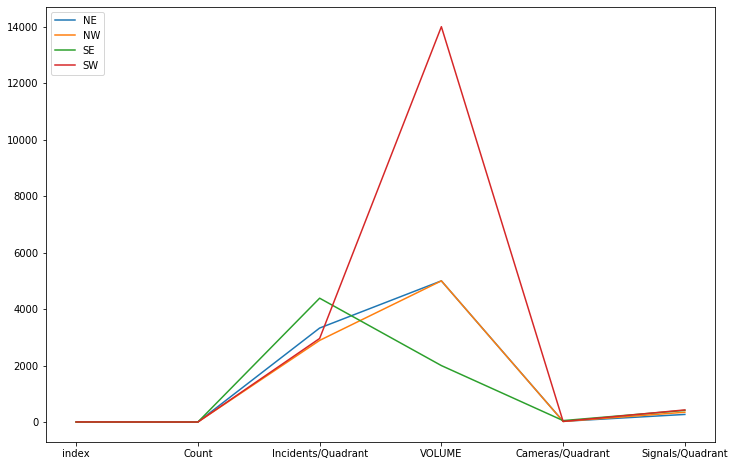

In [59]:
#making informed conclusion using pyplot from matplolib
import matplotlib.pyplot as plt
fig= plt.figure(figsize=(12,8))   
df=df_22
df_1=df.set_index("QUADRANT")
for i in range(len(df)):
    plt.plot([k for k in df_1.columns],[df_1[y].iloc[i] for y in df_1.columns])
plt.legend(df_1.index,loc="upper left")
plt.show()

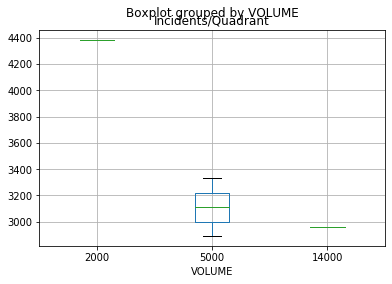

In [60]:
#boxplots to make a conclusion of the incidents per quadrants by volume
df_22.boxplot(column='Incidents/Quadrant', by='VOLUME');

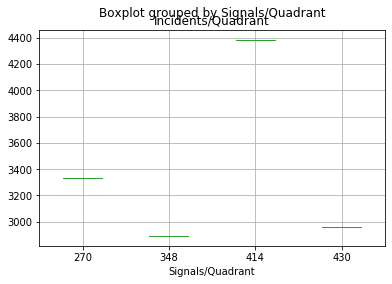

In [61]:
df_22.boxplot(column='Incidents/Quadrant', by='Signals/Quadrant');

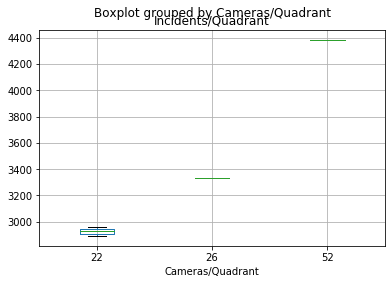

In [62]:
df_22.boxplot(column='Incidents/Quadrant', by='Cameras/Quadrant');

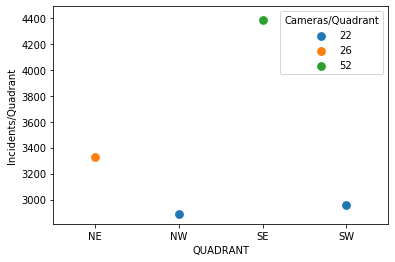

In [63]:
#other plots using point plots
sns.pointplot( y='Incidents/Quadrant',x='QUADRANT', hue='Cameras/Quadrant', ci=None, data=df_22)

# The SE region of Calgary has the highest amount of Traffic Cameras but yet the highest number of Traffic Incidents,while the NW and the SW region have the same amount of Traffic cameras but the SW has a higher number of Traffic Incidents than the NW.

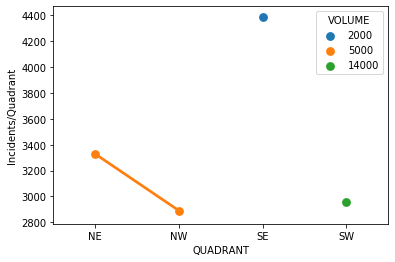

In [64]:
sns.pointplot( y='Incidents/Quadrant',x='QUADRANT', hue='VOLUME', ci=None, data=df_22)

# The North East and the North West Quadrant of Calgary had the same amount of Traffic Volume but yet the North east had a higher number of Traffic Incidents as compared to the North West. Furthermore the South East had the highest Traffic Volume and the highest number of Traffic Incidents.

In [65]:
df_22

,index,QUADRANT,Count,Incidents/Quadrant,VOLUME,Cameras/Quadrant,Signals/Quadrant
0,1,NE,1,3329,5000,26,270
1,2,NW,1,2891,5000,22,348
2,3,SE,1,4386,2000,52,414
3,4,SW,1,2960,14000,22,430


In [66]:
df_22['Signals/Quadrant'] = df_signals_modified5['Signals/Quadrant']
df_22

,index,QUADRANT,Count,Incidents/Quadrant,VOLUME,Cameras/Quadrant,Signals/Quadrant
0,1,NE,1,3329,5000,26,270
1,2,NW,1,2891,5000,22,348
2,3,SE,1,4386,2000,52,414
3,4,SW,1,2960,14000,22,430


In [67]:
sns.pointplot( y='Incidents/Quadrant',x='QUADRANT', hue='Comm Signs/Quadrant', ci=None, data=df_22)

ValueError: Could not interpret input 'Comm Signs/Quadrant'

## The south east quadrant of Calgary had the most Community Signs per Quadrant but yet the highest number of Traffic Incidents, while the NW region had the second highest number of community signs per quadrant but yet the least number of Traffic Incidents. 

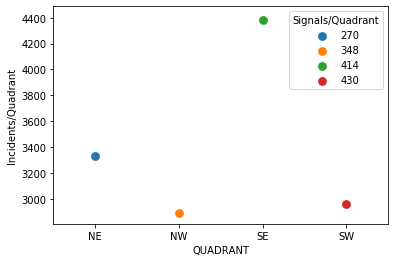

In [68]:
sns.pointplot( y='Incidents/Quadrant',x='QUADRANT', hue='Signals/Quadrant', ci=None, data=df_22)

# The SW region of Calgary has the highest number of signals per quadrant and due to this the number of Traffic Incidents are reduced, it has the second lowest number of incidents , while the SE region has the second highest number of Traffic Cameras per quadrant but yet has the highest number of Incidents/Quadrant. 

# In conclusion the South East Quadrant of Calgary has the highest number of Traffic Incidents no matter the road safety signs or signals.

# Speed on map

In [69]:
#tail display of the map
df_Speed_Limts.tail()

,BOUND,CREATED_DT,DISTANCE,SPEED,STREET_NAME,multiline
1447,S,2018/10/29,NaN,80,STONEY TR NW,MULTILINESTRING ((-114.233241861102 51.0915352...
1448,N/S,2018/10/31,NaN,70,37 ST SW,MULTILINESTRING ((-114.140309947853 50.9177590...
1449,W,2018/11/02,NaN,60,SUN VALLEY BV SE,MULTILINESTRING ((-114.030210417675 50.9043134...
1450,E,NaN,1.85,60,JOHN LAURIE BV,MULTILINESTRING ((-114.177870798005 51.1241752...
1451,NaN,2018/12/06,NaN,60,STONEY TR SE RAMP,MULTILINESTRING ((-113.988645145196 50.8984752...


In [70]:
#importing the speed limits file using csv DictReader, iterating the dataframe 
#for the locations and speed within the grid respectively
with open(r"Speed_Limits.csv") as f:
    line = csv.DictReader(f, delimiter=',')
    for row in line:
        speed = float(row['SPEED'])
        all_locations = row['multiline'][18:-2].replace("), (", ", ").split(',')
        locations = [location.split() for location in all_locations]
        coord_list=[]

In [71]:
pip install geomet

Note: you may need to restart the kernel to use updated packages.


In [72]:
#importing wkt from the installed geomet for loading multistrings
from geomet import wkt

In [73]:
#importing other liberies
import folium
import pandas as pd
import folium.plugins

import branca
import branca.colormap as cm

In [74]:
#colormap for color legend differentiation on the map 
colormap = cm.linear.YlOrRd_06.scale(vmin=15,vmax=110)
colormap


In [75]:
#A plot of the speed map
map_speed = folium.Map(location=[mid_longitude,mid_latitude],control_scale=True)

# parse multiline string for each road as geojson
for i in range(1451):
    ml = json.dumps(wkt.loads(df_Speed_Limts["multiline"][i]))
    
    # plotting each road on map 
    color=colormap(df_Speed_Limts['SPEED'][i])
    folium.GeoJson(ml,style_function= lambda x, color= color:{'color':color}).add_to(map_speed)
    #folium.ColorLine(coor_list, colormap=colormap, colors=speed_list,opacity = 1, weight=3).add_to(map_1)

map_speed

In [76]:
#Adding legend for the map above using html

from branca.element import Template, MacroElement

template = """
{% macro html(this, kwargs) %}

<!doctype html>
<html lang="en">
<head>
  <meta charset="utf-8">
  <meta name="viewport" content="width=device-width, initial-scale=1">
  <title>jQuery UI Draggable - Default functionality</title>
  <link rel="stylesheet" href="//code.jquery.com/ui/1.12.1/themes/base/jquery-ui.css">

  <script src="https://code.jquery.com/jquery-1.12.4.js"></script>
  <script src="https://code.jquery.com/ui/1.12.1/jquery-ui.js"></script>
  
  <script>
  $( function() {
    $( "#maplegend" ).draggable({
                    start: function (event, ui) {
                        $(this).css({
                            right: "auto",
                            top: "auto",
                            bottom: "auto"
                        });
                    }
                });
});

  </script>
</head>
<body>

 
<div id='maplegend' class='maplegend' 
    style='position: absolute; z-index:9999; border:2px solid grey; background-color:rgba(255, 255, 255, 0.8);
     border-radius:6px; padding: 10px; font-size:14px; right: 20px; bottom: 20px;'>
     
<div class='legend-title'>Legend (draggable!)</div>
<div class='legend-scale'>
  <ul class='legend-labels'>
    <li><span style='background:#fff5a2ff;opacity:0.7;'></span>20</li>
    <li><span style='background:#fed774ff;opacity:0.7;'></span>30</li>
    <li><span style='background:#fecd69ff;opacity:0.7;'></span>35</li>
    <li><span style='background:#fec35eff;opacity:0.7;'></span>40</li>
    <li><span style='background:#feb852ff;opacity:0.7;'></span>45</li>
    <li><span style='background:#fea546ff;opacity:0.7;'></span>50</li>
    <li><span style='background:#fe913dff;opacity:0.7;'></span>60</li>
    <li><span style='background:#f86a30ff;opacity:0.7;'></span>70</li>
    <li><span style='background:#f13f21ff;opacity:0.7;'></span>80</li>
    <li><span style='background:#d81f22ff;opacity:0.7;'></span>90</li>
    <li><span style='background:#bd0026ff;opacity:0.7;'></span>100</li>
    <li><span style='background:#bd0026ff;opacity:0.7;'></span>110</li>

  </ul>
</div>
</div>
 
</body>
</html>

<style type='text/css'>
  .maplegend .legend-title {
    text-align: left;
    margin-bottom: 5px;
    font-weight: bold;
    font-size: 90%;
    }
  .maplegend .legend-scale ul {
    margin: 0;
    margin-bottom: 5px;
    padding: 0;
    float: left;
    list-style: none;
    }
  .maplegend .legend-scale ul li {
    font-size: 80%;
    list-style: none;
    margin-left: 0;
    line-height: 18px;
    margin-bottom: 2px;
    }
  .maplegend ul.legend-labels li span {
    display: block;
    float: left;
    height: 16px;
    width: 30px;
    margin-right: 5px;
    margin-left: 0;
    border: 1px solid #999;
    }
  .maplegend .legend-source {
    font-size: 80%;
    color: #777;
    clear: both;
    }
  .maplegend a {
    color: #777;
    }
</style>
{% endmacro %}"""

macro = MacroElement()
macro._template = Template(template)

map_speed.get_root().add_child(macro)

#map_speed

# Show traffic heatmap of 2018

In [77]:
#traffic volume dataframe
df_traffic_volume.head()

,YEAR,SECNAME,Shape_Leng,VOLUME,multilinestring
0,2018,5AVS12,172.570274,22000,MULTILINESTRING ((-114.06036700906716 51.04831...
1,2018,94AVSEWBON,189.451491,5000,MULTILINESTRING ((-114.06876825342002 50.96863...
2,2018,12STNE29,261.453939,5000,MULTILINESTRING ((-114.03372206187294 51.05323...
3,2018,100AVNE1,804.353006,2000,MULTILINESTRING ((-114.01318801277267 51.14336...
4,2018,106AVSE1,507.320869,14000,MULTILINESTRING ((-113.98128756128924 50.95784...


In [78]:
from folium import plugins
from folium.plugins import HeatMap
import re

In [79]:
#data cleaning and looping the traffic volume 
all_rows = []
for i in range(len(df_traffic_volume)):
    coor = re.split(r"[\[\]\(\),]", df_traffic_volume.loc[i]['multilinestring'])
    x = []
    for j in coor:
        try:
            values = j.split()
            x.append([float(values[1]), float(values[0]), float(df_traffic_volume['VOLUME'][i])])  # the database coordinates is flipped
        except:
            continue
    all_rows.append(x)

In [80]:
#displaing all_rows before parsing to HeatMap  
all_rows

[[[51.04831941917631, -114.06036700906716, 22000.0],
  [51.04824965329041, -114.05790835100508, 22000.0]],
 [[50.96863425573366, -114.06876825342002, 5000.0],
  [50.96864796962547, -114.0714654457777, 5000.0]],
 [[51.053232488239935, -114.03372206187294, 5000.0],
  [51.05088210489753, -114.03370889695204, 5000.0]],
 [[51.143369698984344, -114.01318801277267, 2000.0],
  [51.14336996653213, -114.01185606469929, 2000.0],
  [51.14337021891259, -114.01052411660841, 2000.0],
  [51.143370456125645, -114.00919216850117, 2000.0],
  [51.1433706781714, -114.0078602203788, 2000.0],
  [51.143370556434334, -114.00200985736682, 2000.0],
  [51.14337055875275, -114.0016930059354, 2000.0]],
 [[50.95784114177629, -113.98128756128924, 14000.0],
  [50.95784139004773, -113.98123806667255, 14000.0],
  [50.95784137901059, -113.98116948007568, 14000.0],
  [50.95784136140979, -113.98106061975949, 14000.0],
  [50.95784209242986, -113.98096196777304, 14000.0],
  [50.95784156880037, -113.98084393668728, 14000.0],


In [81]:
#importing itertools for chaning list of list
import itertools

all_points= list(itertools.chain(*all_rows))
all_points

[[51.04831941917631, -114.06036700906716, 22000.0],
 [51.04824965329041, -114.05790835100508, 22000.0],
 [50.96863425573366, -114.06876825342002, 5000.0],
 [50.96864796962547, -114.0714654457777, 5000.0],
 [51.053232488239935, -114.03372206187294, 5000.0],
 [51.05088210489753, -114.03370889695204, 5000.0],
 [51.143369698984344, -114.01318801277267, 2000.0],
 [51.14336996653213, -114.01185606469929, 2000.0],
 [51.14337021891259, -114.01052411660841, 2000.0],
 [51.143370456125645, -114.00919216850117, 2000.0],
 [51.1433706781714, -114.0078602203788, 2000.0],
 [51.143370556434334, -114.00200985736682, 2000.0],
 [51.14337055875275, -114.0016930059354, 2000.0],
 [50.95784114177629, -113.98128756128924, 14000.0],
 [50.95784139004773, -113.98123806667255, 14000.0],
 [50.95784137901059, -113.98116948007568, 14000.0],
 [50.95784136140979, -113.98106061975949, 14000.0],
 [50.95784209242986, -113.98096196777304, 14000.0],
 [50.95784156880037, -113.98084393668728, 14000.0],
 [50.957842546402254, -

In [82]:
#heat_map on the map; please zoom in/out for different view form of the heat map 
map_heat = folium.Map(location=[mid_longitude,mid_latitude],control_scale=True)
HeatMap(all_points, radius = 7).add_to(map_heat)
map_heat

### There is more Traffic volume downtown calgary